In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!git clone https://github.com/IDEA-Research/DINO.git
!mv DINO/* .
!rm -r DINO
!pip install -r requirements.txt
!pip install "numpy<1.24" "yapf==0.40.1"

Cloning into 'DINO'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (196/196), done.
remote: Compressing objects: 100% (101/101), done.
remote: Total 442 (delta 136), reused 95 (delta 95), pack-reused 246 (from 1)
Receiving objects: 100% (442/442), 13.43 MiB | 18.29 MiB/s, done.
Resolving deltas: 100% (191/191), done.
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-install-o22ifpyl/pycocotools_cbd5995174984ab6a40776235580acc4
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-install-o22ifpyl/pycocotools_cbd5995174984ab6a40776235580acc4
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/cocodataset/panopticapi.git to /tmp/pip-install-o22ifpyl/panopticapi_5d355a85e9af4a41ad75f4c6635a7aee
  Running command git clone --filter=blob:none --quiet https://github.com/cocodat

In [ ]:
!python models/dino/ops/setup.py build install

running build
running build_py
creating build/lib.linux-x86_64-cpython-310/datasets
copying datasets/random_crop.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/transforms.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/data_util.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/dataset.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/panoptic_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/sltransform.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_panoptic.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/__init__.py -> build/lib.linux-x86_64-cpython-310/datasets
creating build/lib.linux-x86_64-cpython-310/models
copying models/registry.py -> build/lib.linux-x86_64-cpython-310/models
copying models/__i

In [ ]:
!python models/dino/ops/test.py

* True check_forward_equal_with_pytorch_double: max_abs_err 8.67e-19 max_rel_err 2.35e-16
* True check_forward_equal_with_pytorch_float: max_abs_err 4.66e-10 max_rel_err 1.13e-07
* True check_gradient_numerical(D=30)
* True check_gradient_numerical(D=32)
* True check_gradient_numerical(D=64)
* True check_gradient_numerical(D=71)
* True check_gradient_numerical(D=1025)
Traceback (most recent call last):
  File "/content/models/dino/ops/test.py", line 86, in <module>
    check_gradient_numerical(channels, True, True, True)
  File "/content/models/dino/ops/test.py", line 76, in check_gradient_numerical
    gradok = gradcheck(func, (value.double(), shapes, level_start_index, sampling_locations.double(), attention_weights.double(), im2col_step))
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2052, in gradcheck
    return _gradcheck_helper(**args)
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2081, in _gradcheck_helper


In [ ]:
!cp /content/drive/MyDrive/pedestrian_detection/checkpoint0011_4scale.pth /content/
!cp -r /content/drive/MyDrive/pedestrian_detection/processed_dataset /content/

In [3]:
!bash /content/scripts/DINO_eval.sh /content/processed_dataset /content/checkpoint0011_4scale.pth

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[10/26 17:39:19.334]: git:
  sha: N/A, status: clean, branch: N/A

[10/26 17:39:19.334]: Command: main.py --output_dir logs/DINO/R50-MS4-%j -c config/DINO/DINO_4scale.py --coco_path /content/processed_dataset --eval --resume /content/checkpoint0011_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[10/26 17:39:19.335]: Full config saved to logs/DINO/R50-MS4-%j/config_args_all.json
[10/26 17:39:19.335]: world size: 1
[10/26 17:39:19.335]: rank: 0
[10/26 17:39:19.335]: local_rank: 0
[10/26 17:39:19.335]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/processed_dataset', coco_pan

<ipython-input-4-d129a16e8255>:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_checkpoint_path, map_location='cpu')


data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


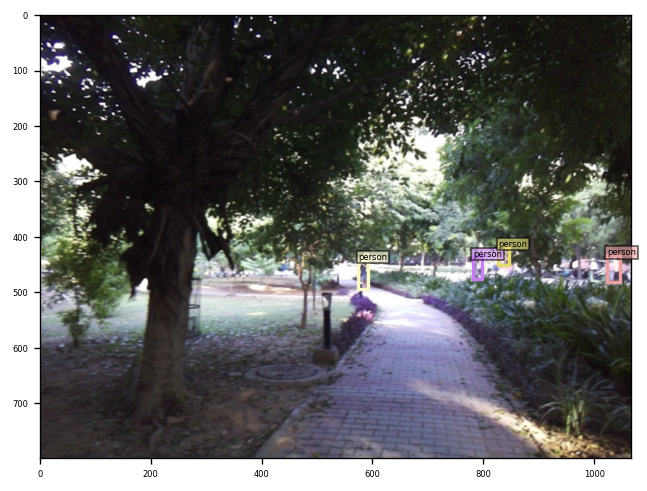

savename: /content/figs/pre_trained_model_person_inference/pred_0000-2-2024-10-26-17:39:30.968871.png


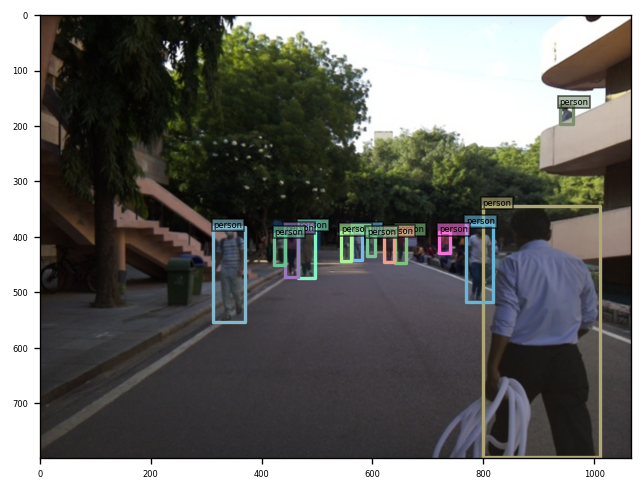

savename: /content/figs/pre_trained_model_person_inference/pred_0001-9-2024-10-26-17:39:31.518926.png


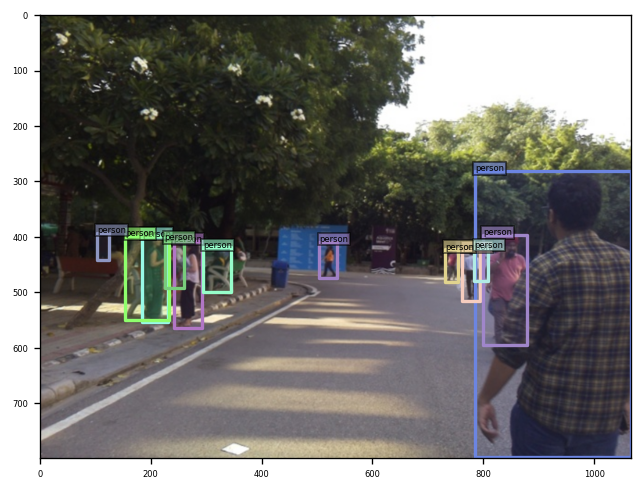

savename: /content/figs/pre_trained_model_person_inference/pred_0002-13-2024-10-26-17:39:32.074615.png


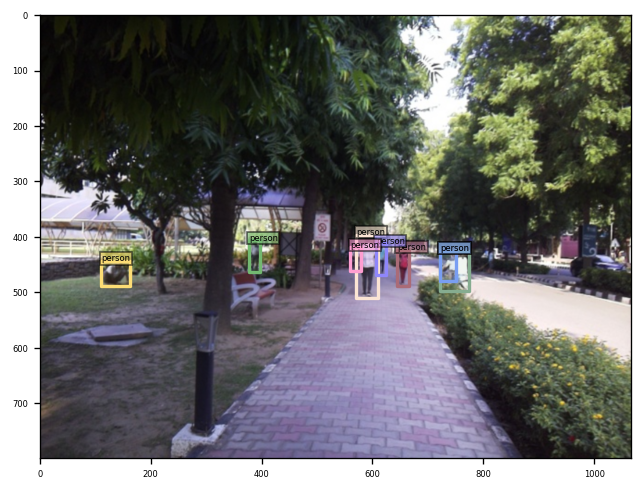

savename: /content/figs/pre_trained_model_person_inference/pred_0003-14-2024-10-26-17:39:32.642385.png


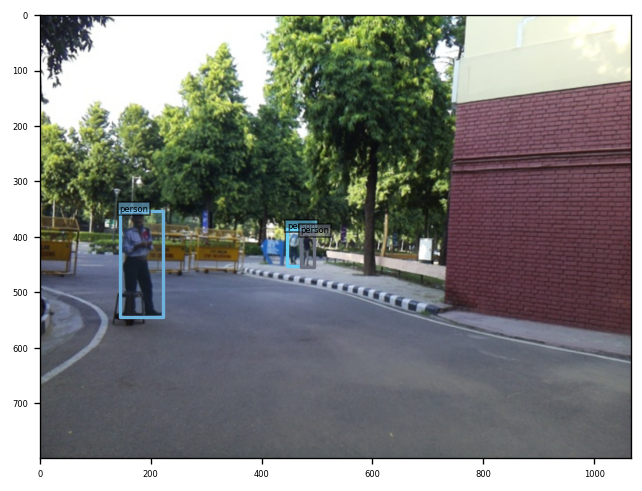

savename: /content/figs/pre_trained_model_person_inference/pred_0004-36-2024-10-26-17:39:33.175183.png


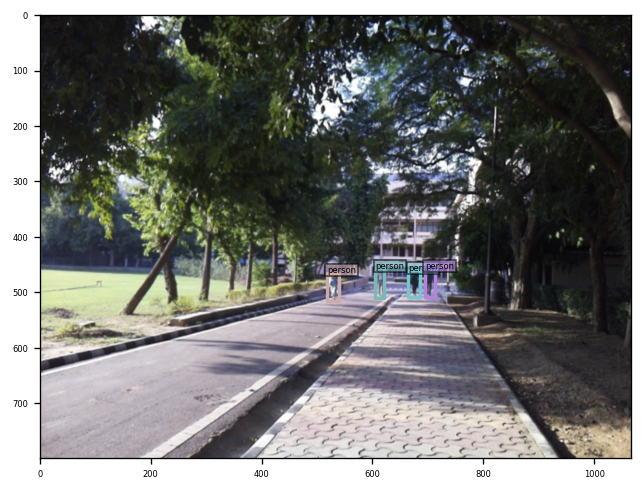

savename: /content/figs/pre_trained_model_person_inference/pred_0005-37-2024-10-26-17:39:33.757197.png


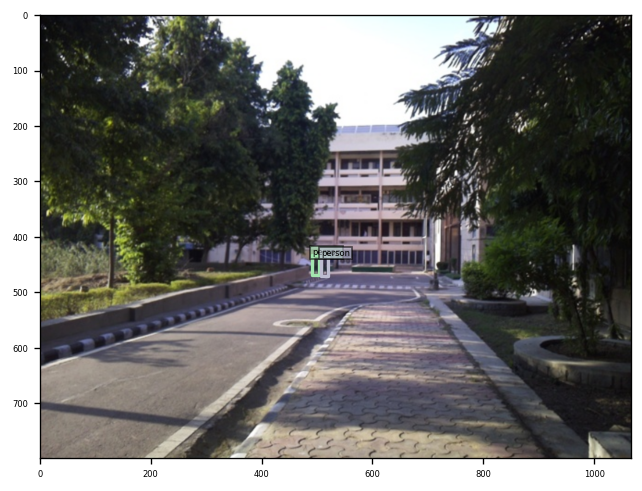

savename: /content/figs/pre_trained_model_person_inference/pred_0006-42-2024-10-26-17:39:34.303018.png


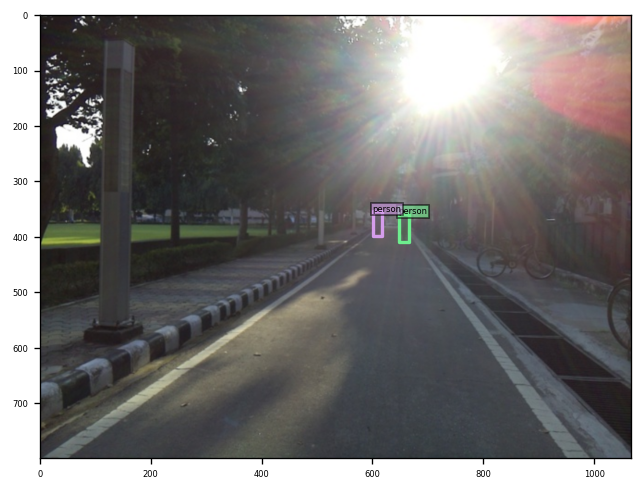

savename: /content/figs/pre_trained_model_person_inference/pred_0007-43-2024-10-26-17:39:34.844823.png


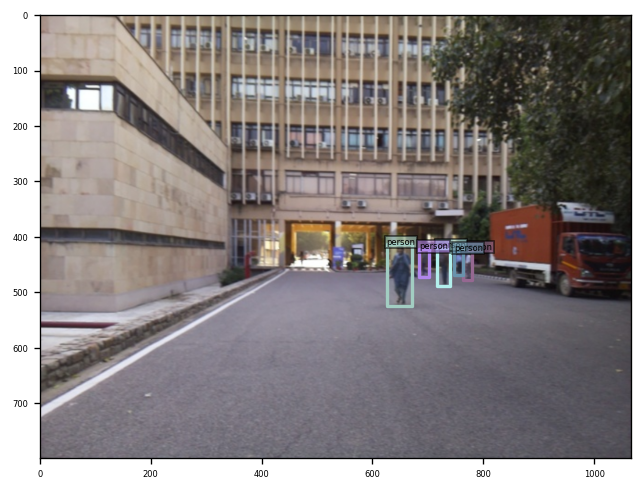

savename: /content/figs/pre_trained_model_person_inference/pred_0008-55-2024-10-26-17:39:35.396048.png


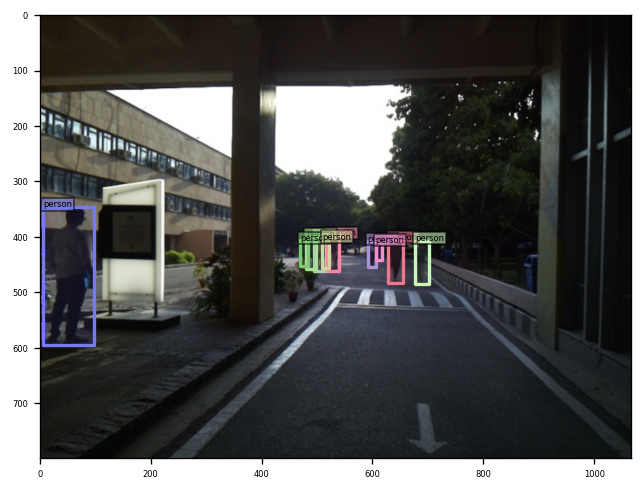

savename: /content/figs/pre_trained_model_person_inference/pred_0009-59-2024-10-26-17:39:35.938699.png


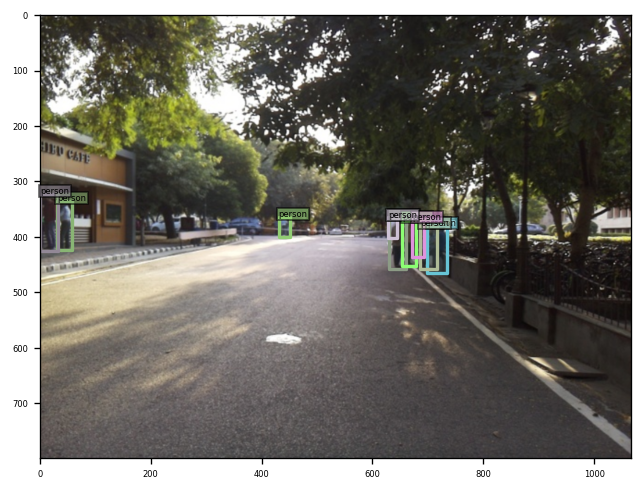

savename: /content/figs/pre_trained_model_person_inference/pred_0010-68-2024-10-26-17:39:36.506225.png


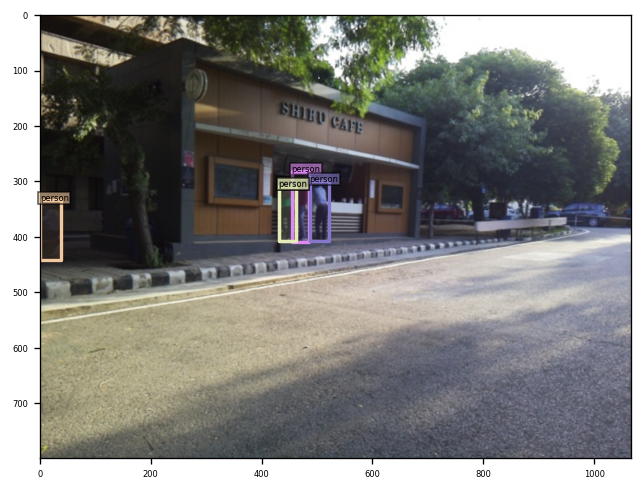

savename: /content/figs/pre_trained_model_person_inference/pred_0011-69-2024-10-26-17:39:37.071129.png


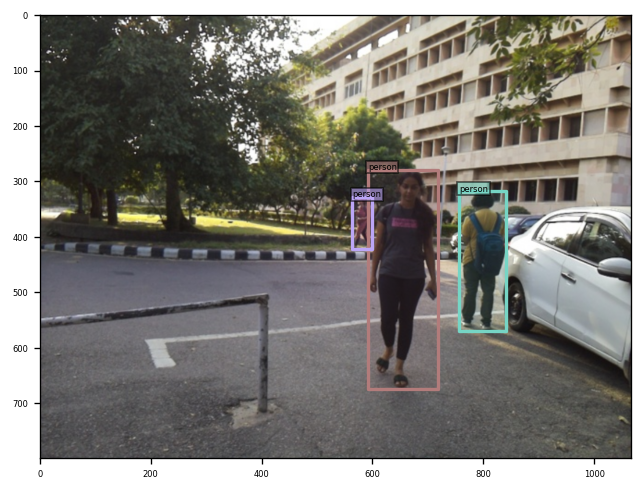

savename: /content/figs/pre_trained_model_person_inference/pred_0012-76-2024-10-26-17:39:37.638215.png


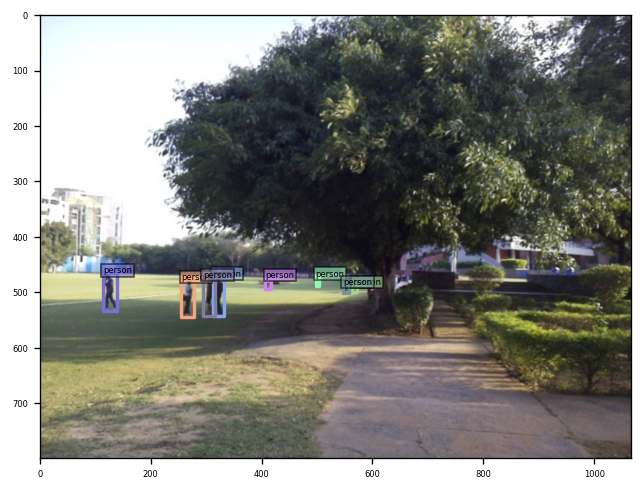

savename: /content/figs/pre_trained_model_person_inference/pred_0013-79-2024-10-26-17:39:38.182941.png


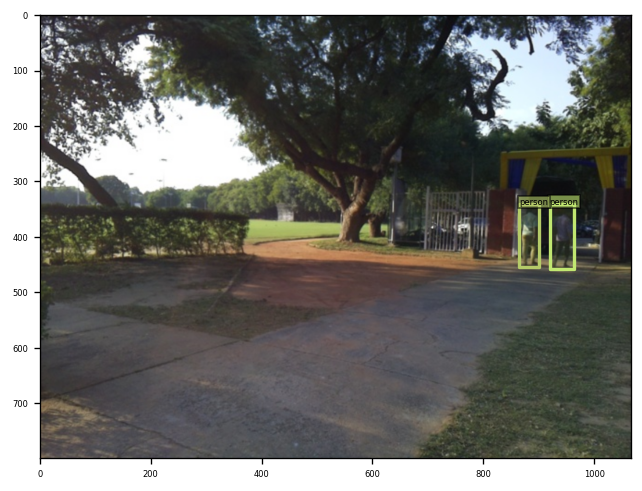

savename: /content/figs/pre_trained_model_person_inference/pred_0014-86-2024-10-26-17:39:38.728487.png


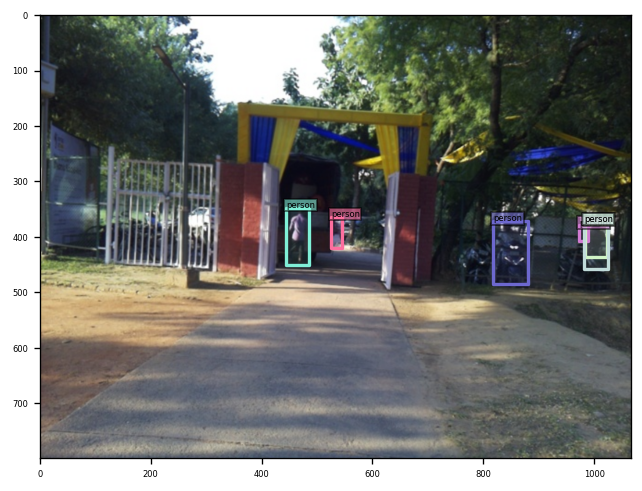

savename: /content/figs/pre_trained_model_person_inference/pred_0015-90-2024-10-26-17:39:39.525483.png


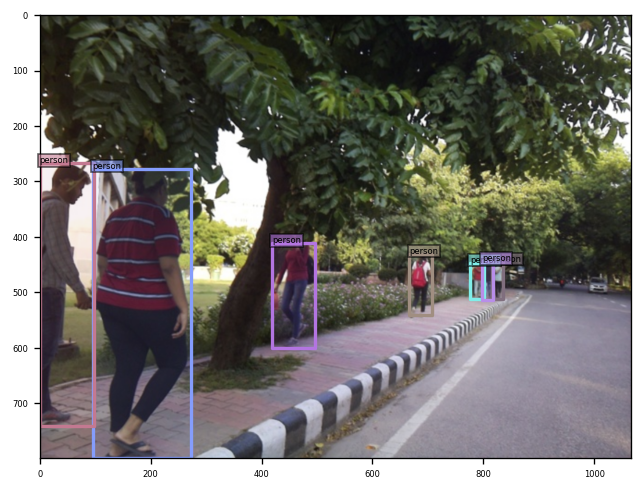

savename: /content/figs/pre_trained_model_person_inference/pred_0016-94-2024-10-26-17:39:40.081614.png


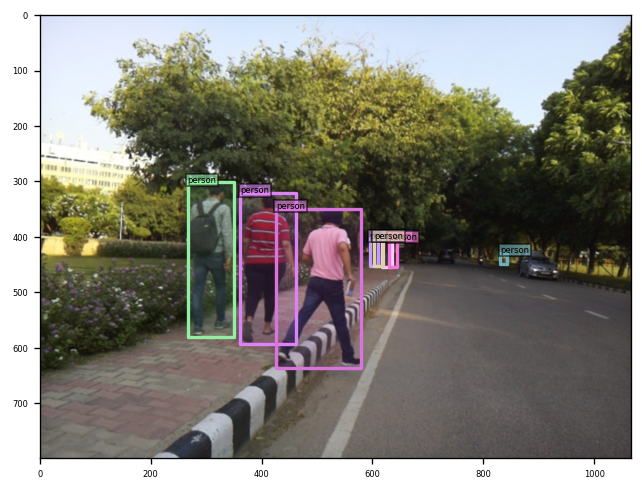

savename: /content/figs/pre_trained_model_person_inference/pred_0017-95-2024-10-26-17:39:40.637329.png


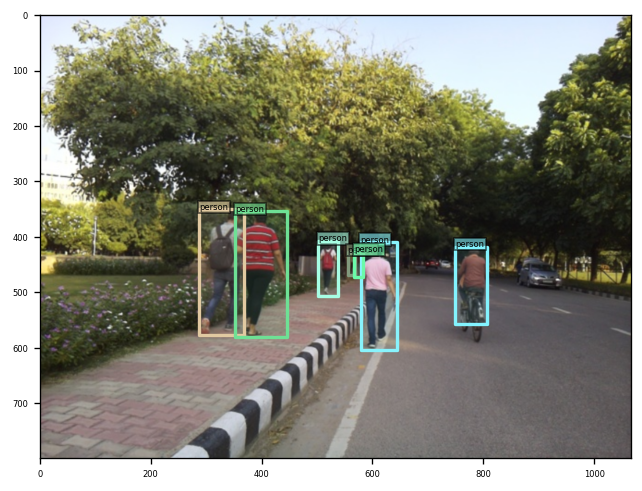

savename: /content/figs/pre_trained_model_person_inference/pred_0018-96-2024-10-26-17:39:41.192648.png


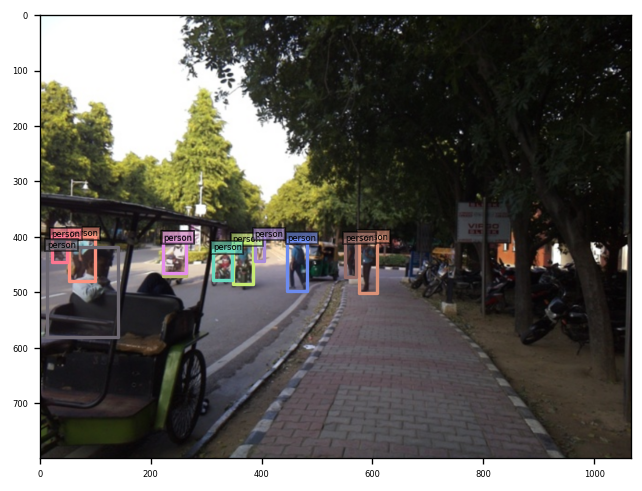

savename: /content/figs/pre_trained_model_person_inference/pred_0019-106-2024-10-26-17:39:41.754388.png


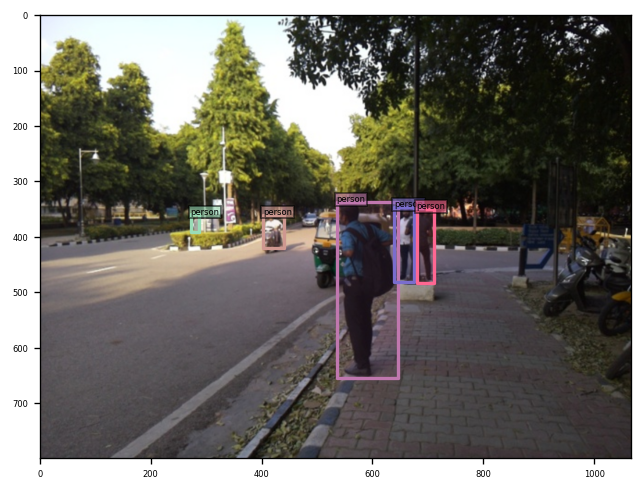

savename: /content/figs/pre_trained_model_person_inference/pred_0020-109-2024-10-26-17:39:42.305910.png


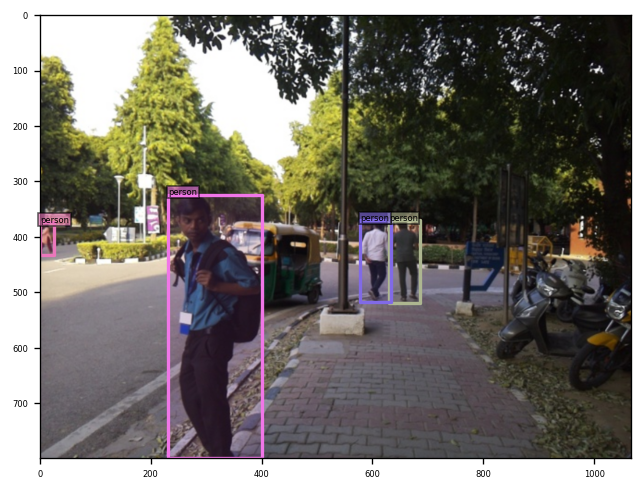

savename: /content/figs/pre_trained_model_person_inference/pred_0021-110-2024-10-26-17:39:42.864902.png


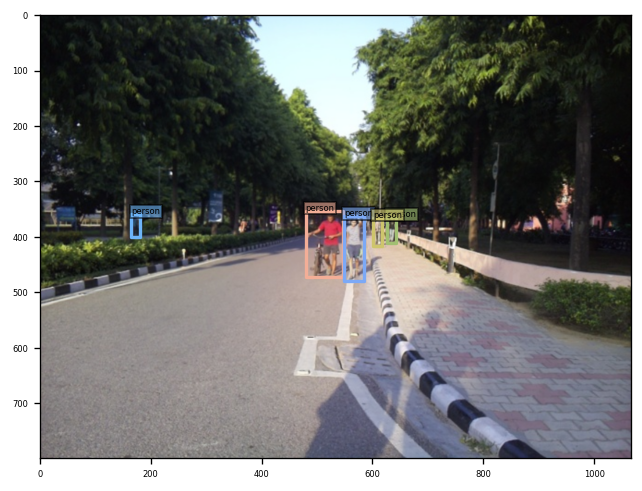

savename: /content/figs/pre_trained_model_person_inference/pred_0022-113-2024-10-26-17:39:43.414820.png


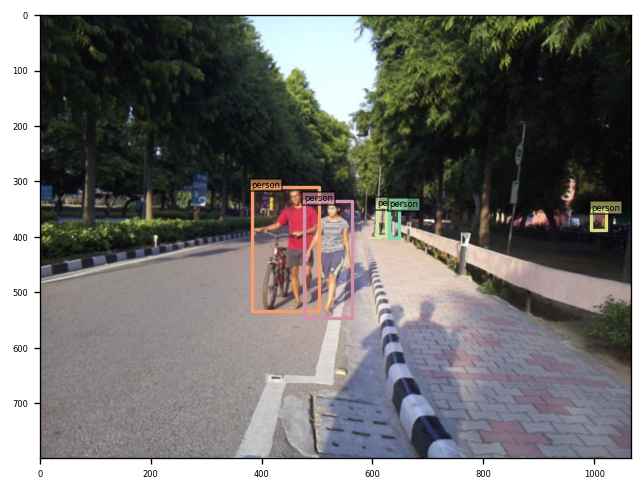

savename: /content/figs/pre_trained_model_person_inference/pred_0023-115-2024-10-26-17:39:43.970609.png


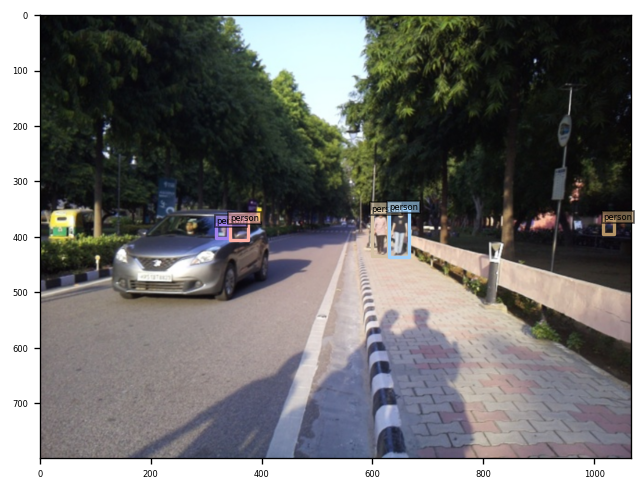

savename: /content/figs/pre_trained_model_person_inference/pred_0024-118-2024-10-26-17:39:44.546930.png


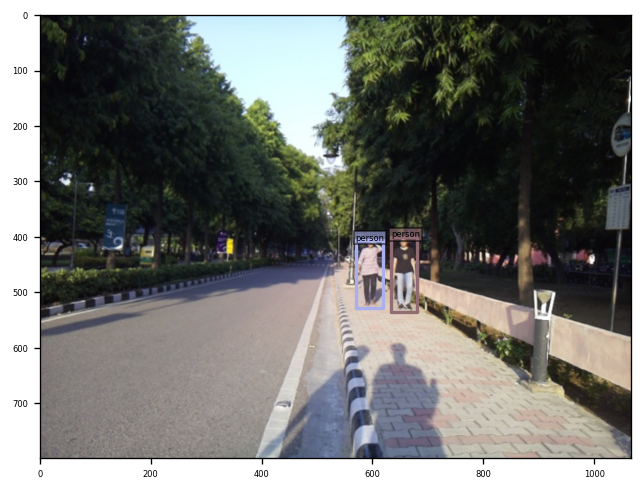

savename: /content/figs/pre_trained_model_person_inference/pred_0025-119-2024-10-26-17:39:45.125872.png


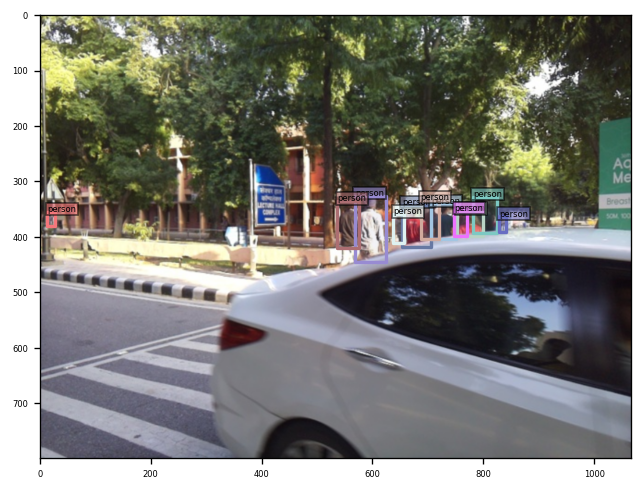

savename: /content/figs/pre_trained_model_person_inference/pred_0026-123-2024-10-26-17:39:45.705388.png


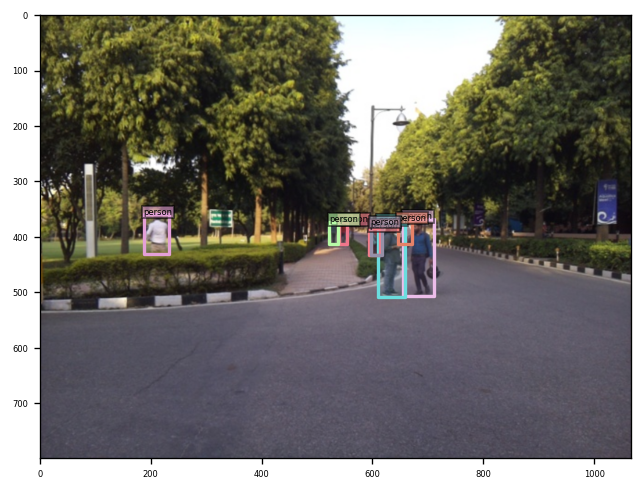

savename: /content/figs/pre_trained_model_person_inference/pred_0027-128-2024-10-26-17:39:46.252984.png


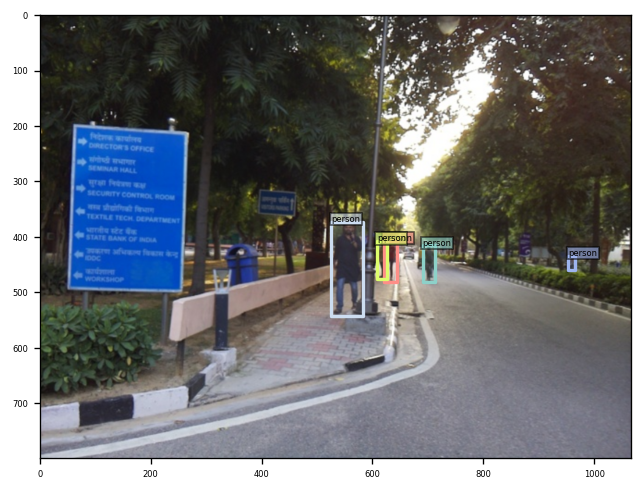

savename: /content/figs/pre_trained_model_person_inference/pred_0028-141-2024-10-26-17:39:46.822696.png


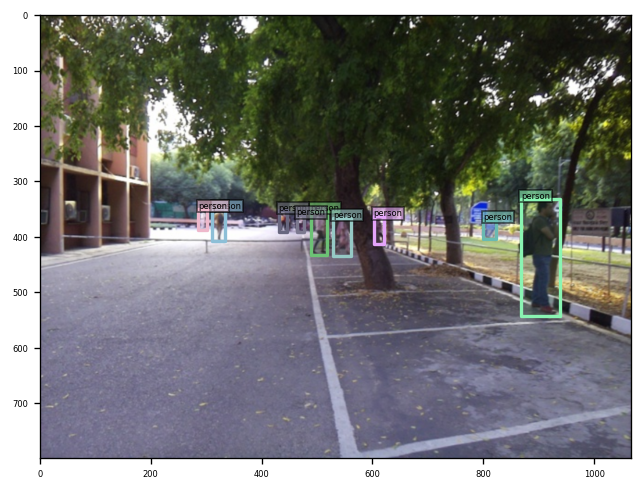

savename: /content/figs/pre_trained_model_person_inference/pred_0029-150-2024-10-26-17:39:47.390452.png


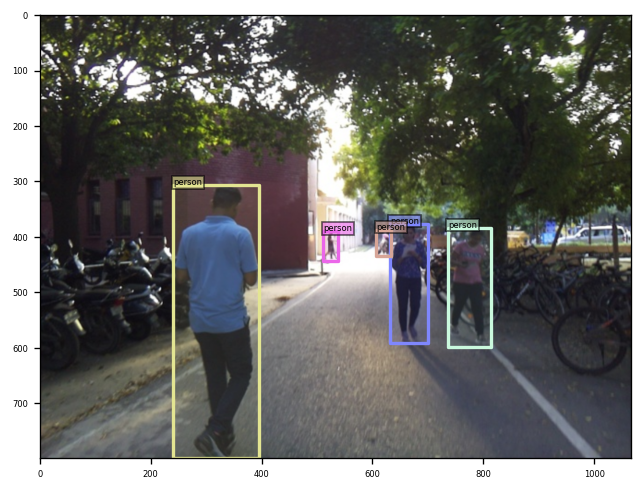

savename: /content/figs/pre_trained_model_person_inference/pred_0030-156-2024-10-26-17:39:47.941209.png


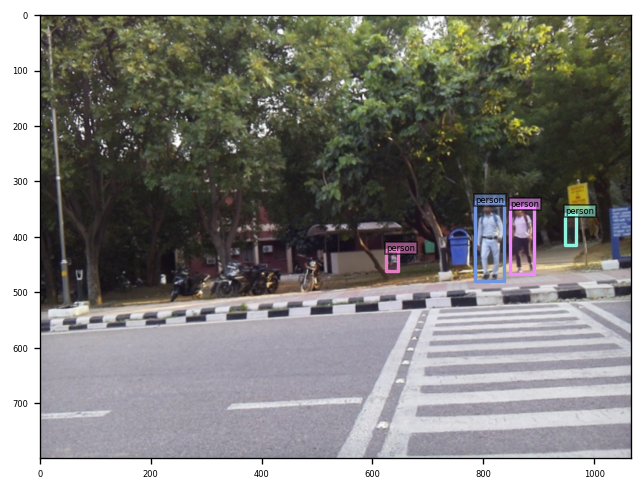

savename: /content/figs/pre_trained_model_person_inference/pred_0031-164-2024-10-26-17:39:48.522691.png


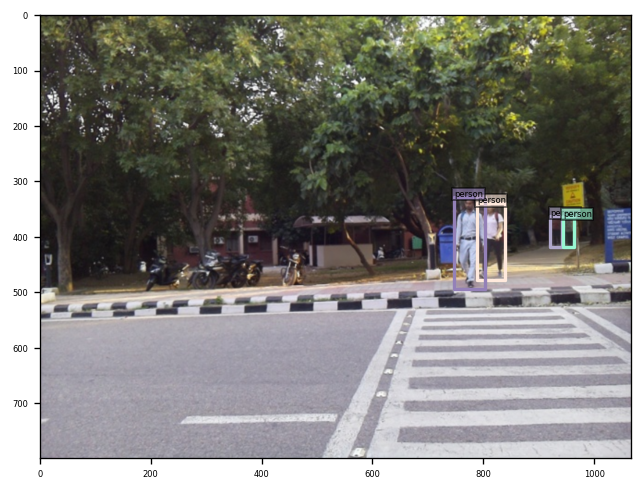

savename: /content/figs/pre_trained_model_person_inference/pred_0032-165-2024-10-26-17:39:49.086897.png


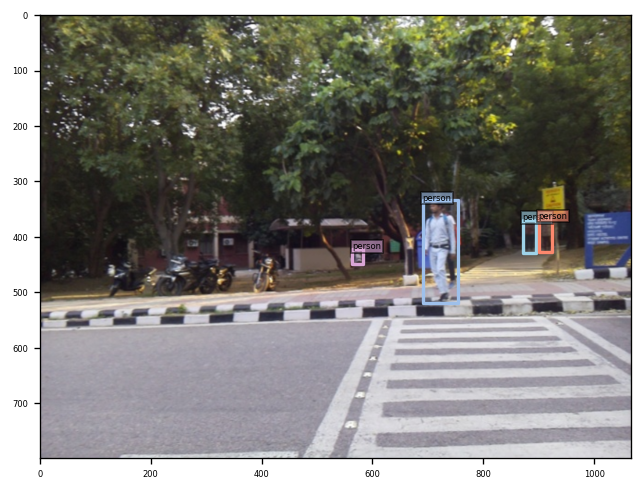

savename: /content/figs/pre_trained_model_person_inference/pred_0033-166-2024-10-26-17:39:49.648516.png


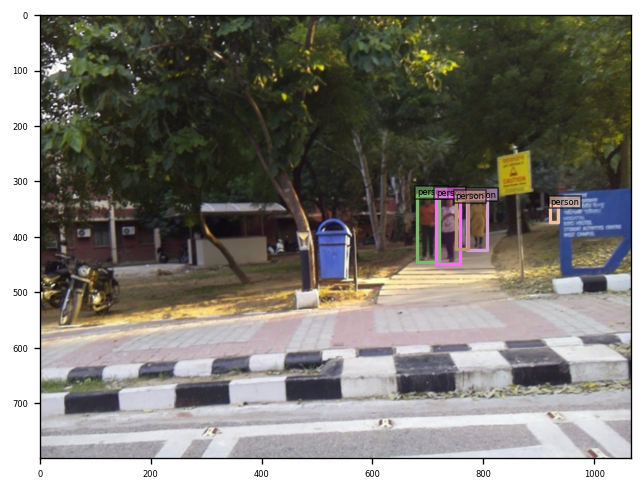

savename: /content/figs/pre_trained_model_person_inference/pred_0034-172-2024-10-26-17:39:50.210906.png


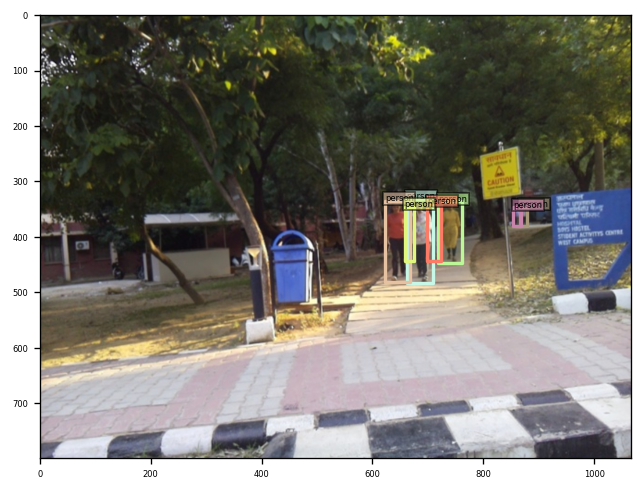

savename: /content/figs/pre_trained_model_person_inference/pred_0035-173-2024-10-26-17:39:50.786782.png


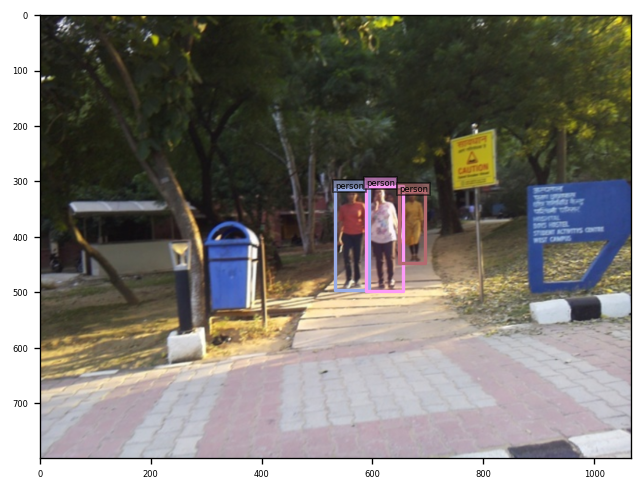

savename: /content/figs/pre_trained_model_person_inference/pred_0036-175-2024-10-26-17:39:51.336923.png


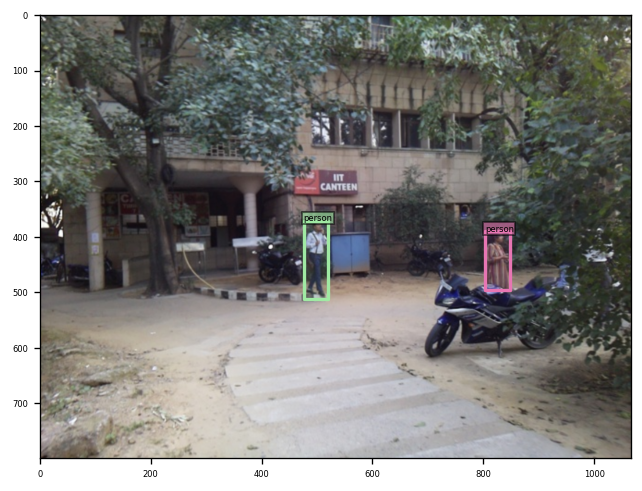

savename: /content/figs/pre_trained_model_person_inference/pred_0037-176-2024-10-26-17:39:51.906074.png


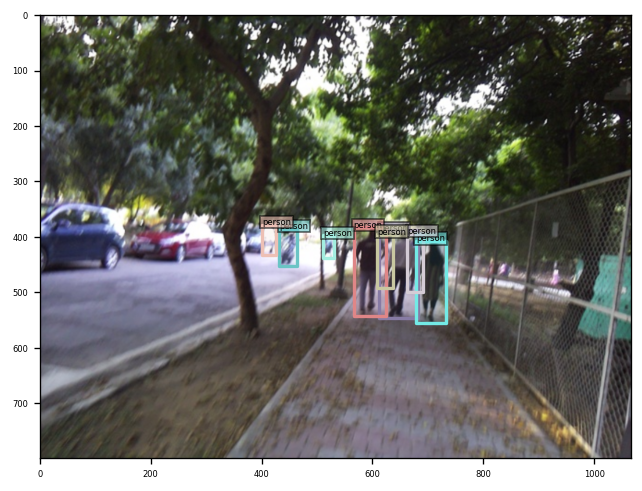

savename: /content/figs/pre_trained_model_person_inference/pred_0038-186-2024-10-26-17:39:52.486596.png


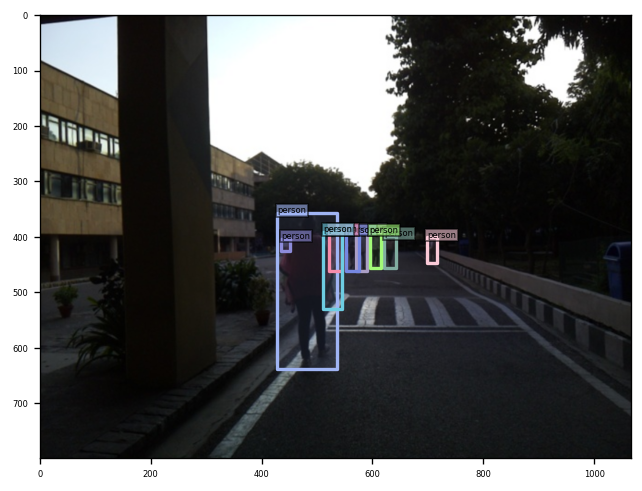

savename: /content/figs/pre_trained_model_person_inference/pred_0039-197-2024-10-26-17:39:53.004467.png
Error idx: 40


In [4]:
import torch
import json
from main import build_model_main
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

model_config_path = "/content/config/DINO/DINO_4scale.py"
model_checkpoint_path = "/content/checkpoint0011_4scale.pth"

args = SLConfig.fromfile(model_config_path)
args.device = 'cuda'
model, criterion, postprocessors = build_model_main(args)
checkpoint = torch.load(model_checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint['model'])
_ = model.eval()

with open('/content/util/coco_id2name.json') as f:
    id2name = json.load(f)
    id2name = {int(k): v for k, v in id2name.items()}

args.dataset_file = 'coco'
args.coco_path = "/content/processed_dataset"  # The path of coco or your custom dataset
args.fix_size = False

dataset_val = build_dataset(image_set='val', args=args)

for i, batch in enumerate(dataset_val):
    image, targets = batch
    output = model.cuda()(image[None].cuda())
    output = postprocessors['bbox'](output, torch.Tensor([[1.0, 1.0]]).cuda())[0]
    threshold = 0.3

    scores = output['scores']
    labels = output['labels']
    boxes = box_ops.box_xyxy_to_cxcywh(output['boxes'])

    person_class_id = 1
    select_mask = (scores > threshold) & (labels == person_class_id)

    box_label = [id2name[int(item)] for item in labels[select_mask]]
    pred_dict = {
        'boxes': boxes[select_mask],
        'image_id': targets['image_id'],
        'size': targets['size'],
        'box_label': box_label
    }

    vslzr = COCOVisualizer()
    vslzr.visualize(image, pred_dict, caption=f"pred_{str(i).zfill(4)}", savedir='/content/figs/pre_trained_model_person_inference')

In [7]:
!bash /content/scripts/DINO_train.sh /content/processed_dataset

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[10/26 17:42:20.410]: git:
  sha: N/A, status: clean, branch: N/A

[10/26 17:42:20.410]: Command: main.py --output_dir logs/DINO/R50-MS4 -c config/DINO/DINO_4scale.py --coco_path /content/processed_dataset --options dn_scalar=100 embed_init_tgt=TRUE --finetune_ignore label_enc.weight class_embed --pretrain_model_path /content/checkpoint0011_4scale.pth
[10/26 17:42:20.411]: Full config saved to logs/DINO/R50-MS4/config_args_all.json
[10/26 17:42:20.411]: world size: 1
[10/26 17:42:20.411]: rank: 0
[10/26 17:42:20.411]: local_rank: 0
[10/26 17:42:20.411]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True}, dataset_file='coco', coco_path='/content/processed_dataset', coco_panoptic_path=None, remove_difficult=False, fix_size=False, output_dir='logs/DINO/R50-MS4', note='', device='cuda', 

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
<ipython-input-8-f05e1b4ac26b>:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more detail

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


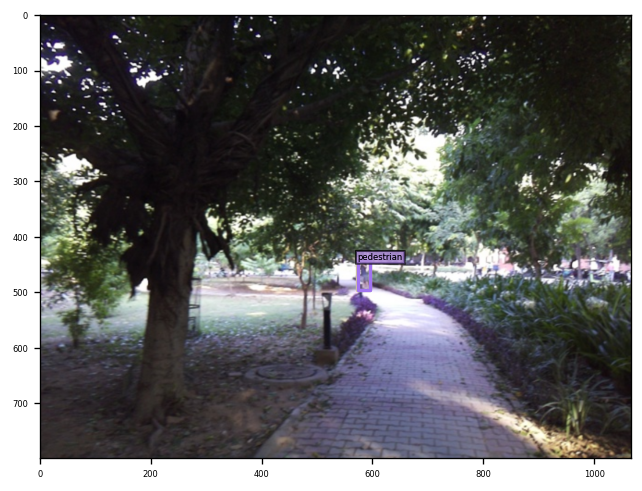

savename: /content/figs/finetuned_model_person_inference/pred_0000.png-2-2024-10-26-17:54:50.125264.png


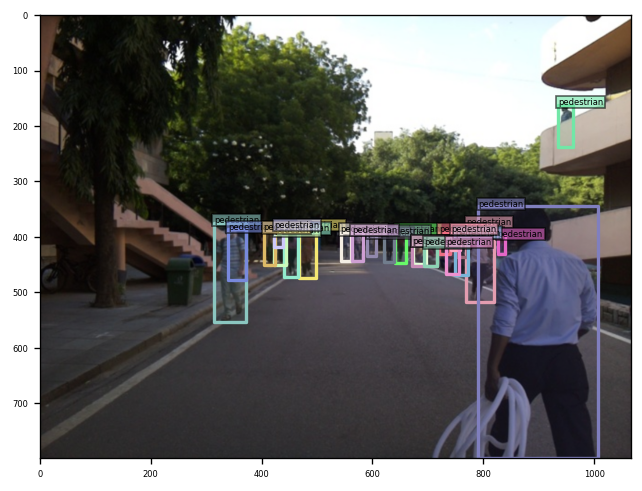

savename: /content/figs/finetuned_model_person_inference/pred_0001.png-9-2024-10-26-17:54:50.704454.png


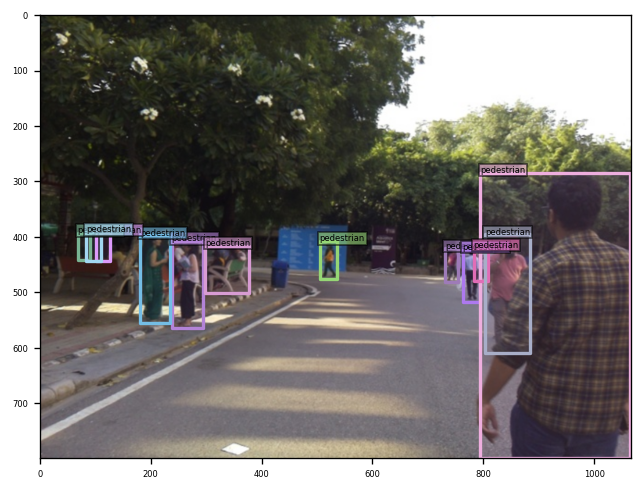

savename: /content/figs/finetuned_model_person_inference/pred_0002.png-13-2024-10-26-17:54:51.265847.png


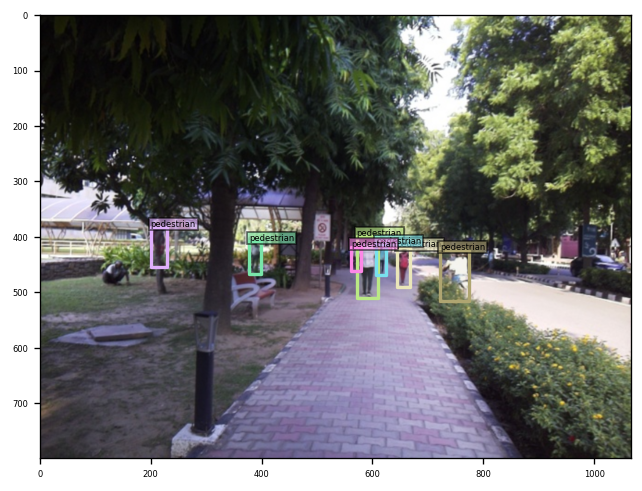

savename: /content/figs/finetuned_model_person_inference/pred_0003.png-14-2024-10-26-17:54:51.825421.png


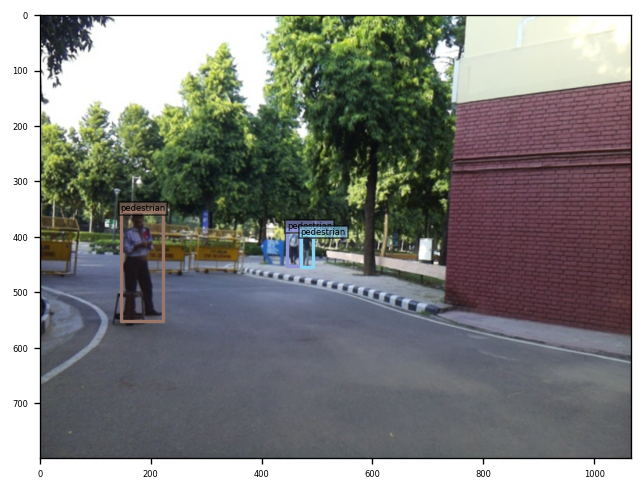

savename: /content/figs/finetuned_model_person_inference/pred_0004.png-36-2024-10-26-17:54:52.356009.png


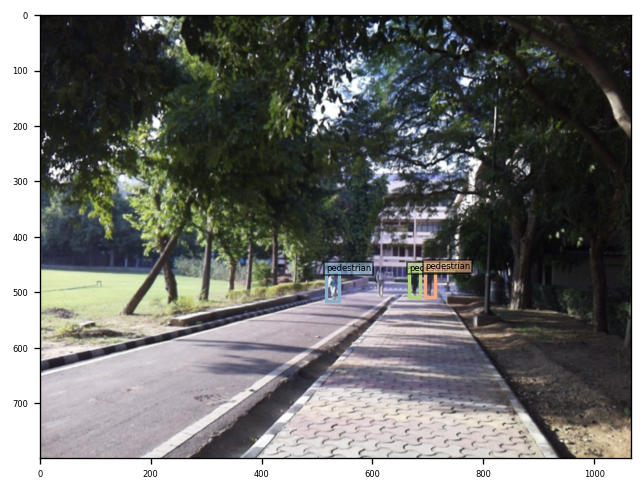

savename: /content/figs/finetuned_model_person_inference/pred_0005.png-37-2024-10-26-17:54:52.907681.png


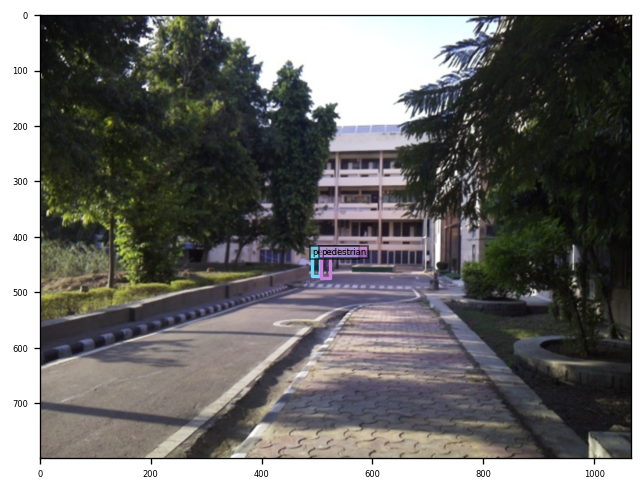

savename: /content/figs/finetuned_model_person_inference/pred_0006.png-42-2024-10-26-17:54:53.447842.png


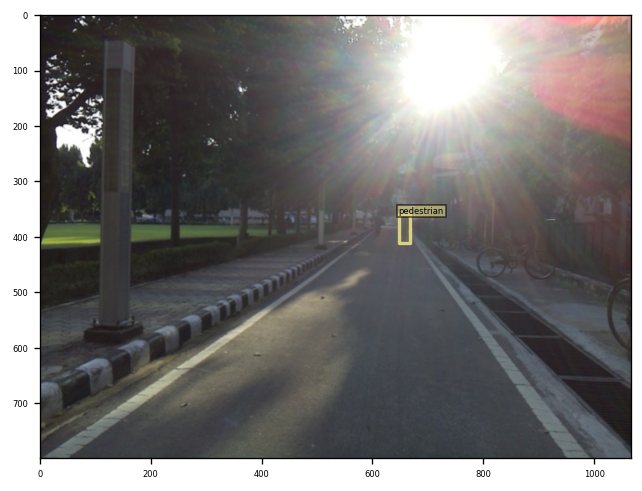

savename: /content/figs/finetuned_model_person_inference/pred_0007.png-43-2024-10-26-17:54:53.980399.png


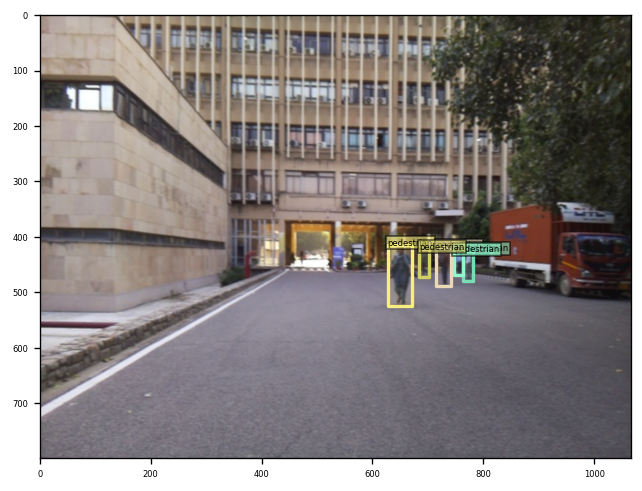

savename: /content/figs/finetuned_model_person_inference/pred_0008.png-55-2024-10-26-17:54:54.768396.png


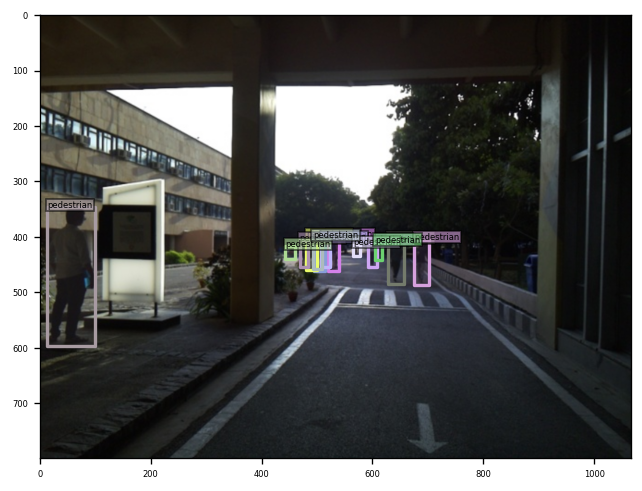

savename: /content/figs/finetuned_model_person_inference/pred_0009.png-59-2024-10-26-17:54:55.343059.png


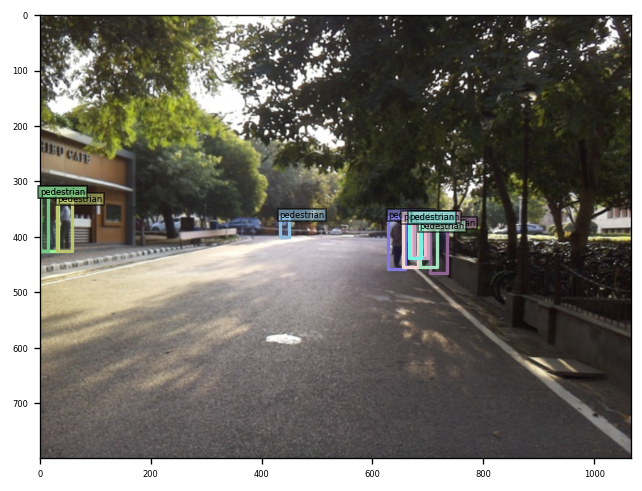

savename: /content/figs/finetuned_model_person_inference/pred_0010.png-68-2024-10-26-17:54:55.910515.png


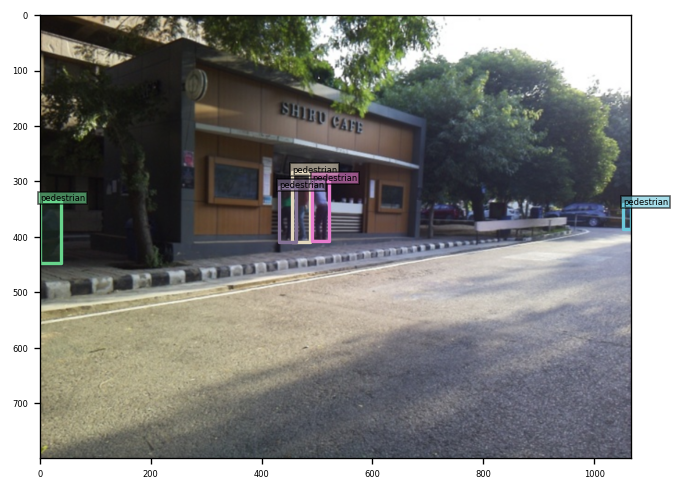

savename: /content/figs/finetuned_model_person_inference/pred_0011.png-69-2024-10-26-17:54:56.456199.png


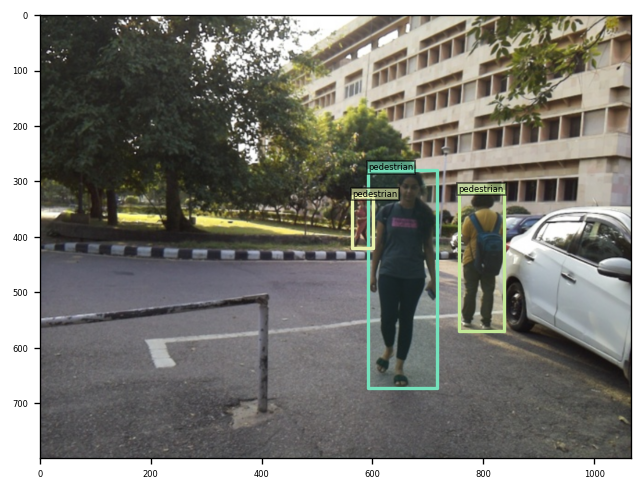

savename: /content/figs/finetuned_model_person_inference/pred_0012.png-76-2024-10-26-17:54:57.000536.png


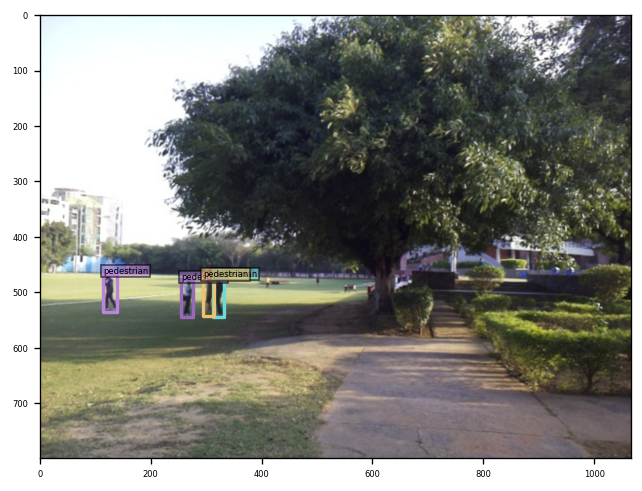

savename: /content/figs/finetuned_model_person_inference/pred_0013.png-79-2024-10-26-17:54:57.537512.png


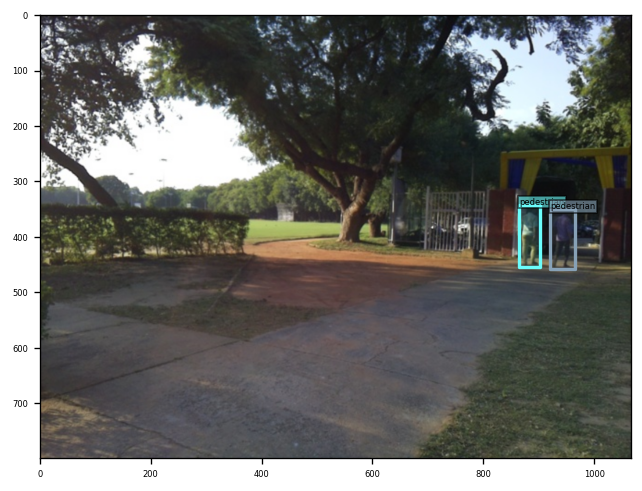

savename: /content/figs/finetuned_model_person_inference/pred_0014.png-86-2024-10-26-17:54:58.084048.png


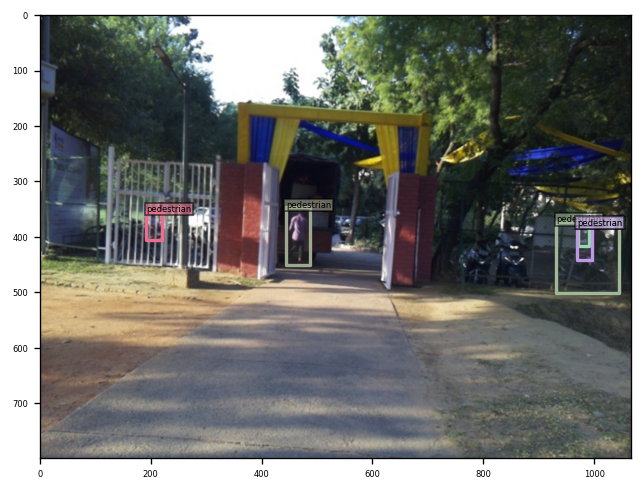

savename: /content/figs/finetuned_model_person_inference/pred_0015.png-90-2024-10-26-17:54:58.657431.png


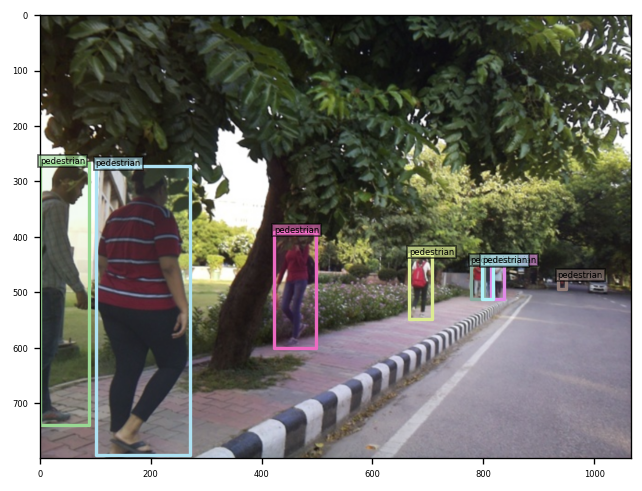

savename: /content/figs/finetuned_model_person_inference/pred_0016.png-94-2024-10-26-17:54:59.212256.png


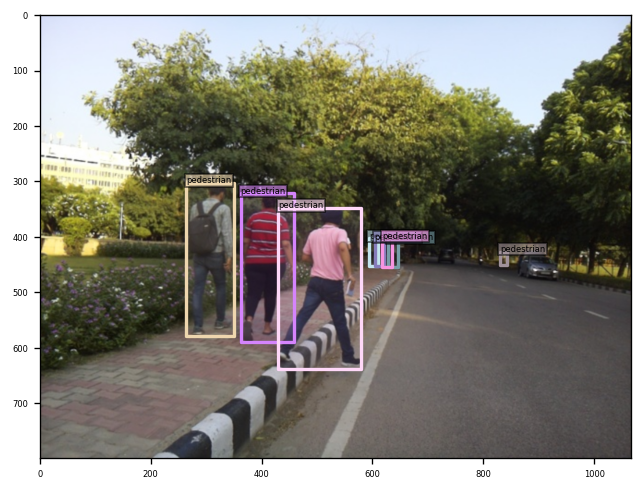

savename: /content/figs/finetuned_model_person_inference/pred_0017.png-95-2024-10-26-17:54:59.757352.png


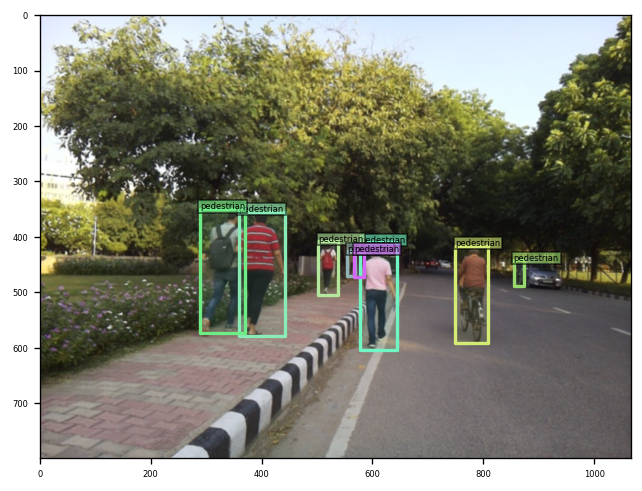

savename: /content/figs/finetuned_model_person_inference/pred_0018.png-96-2024-10-26-17:55:00.324449.png


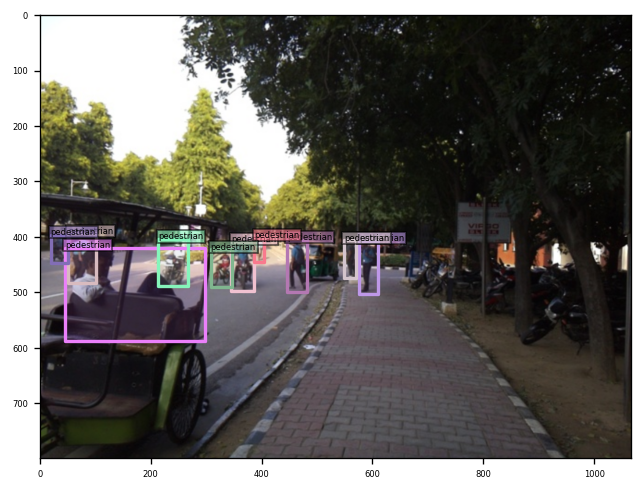

savename: /content/figs/finetuned_model_person_inference/pred_0019.png-106-2024-10-26-17:55:00.873089.png


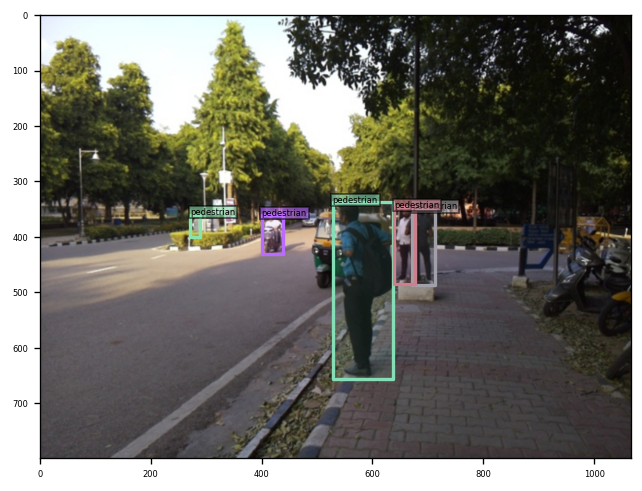

savename: /content/figs/finetuned_model_person_inference/pred_0020.png-109-2024-10-26-17:55:01.422905.png


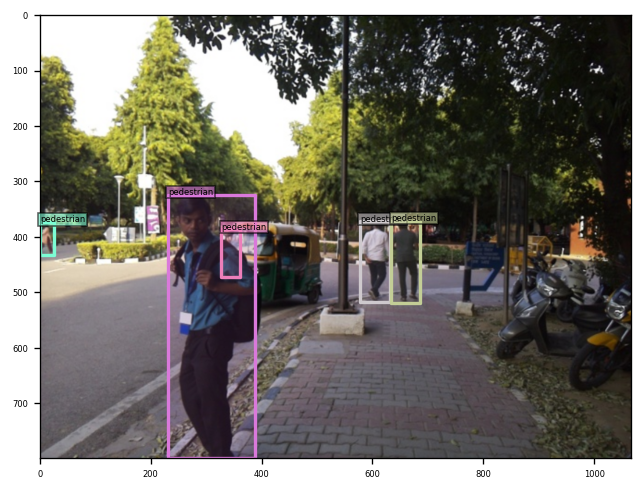

savename: /content/figs/finetuned_model_person_inference/pred_0021.png-110-2024-10-26-17:55:01.980195.png


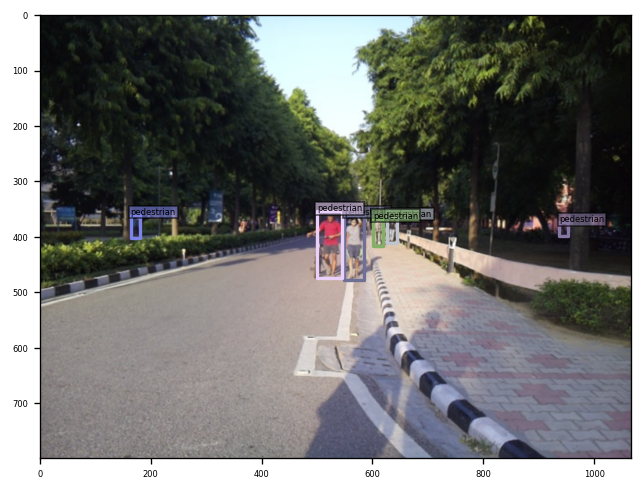

savename: /content/figs/finetuned_model_person_inference/pred_0022.png-113-2024-10-26-17:55:02.545635.png


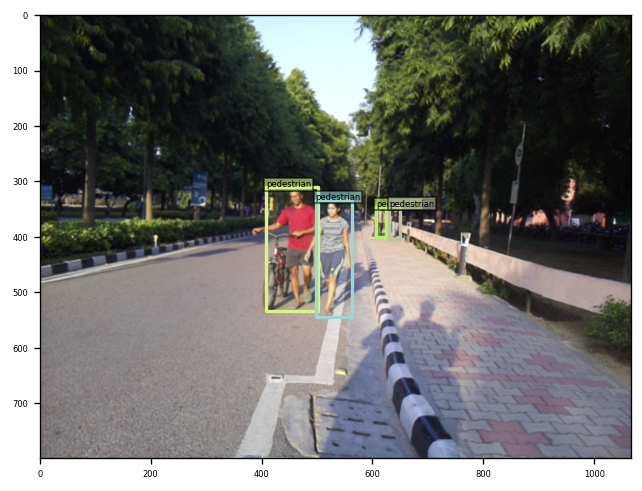

savename: /content/figs/finetuned_model_person_inference/pred_0023.png-115-2024-10-26-17:55:03.094135.png


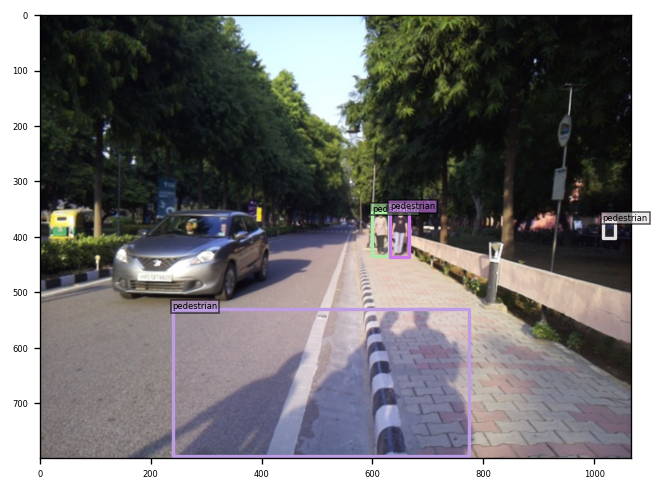

savename: /content/figs/finetuned_model_person_inference/pred_0024.png-118-2024-10-26-17:55:03.645720.png


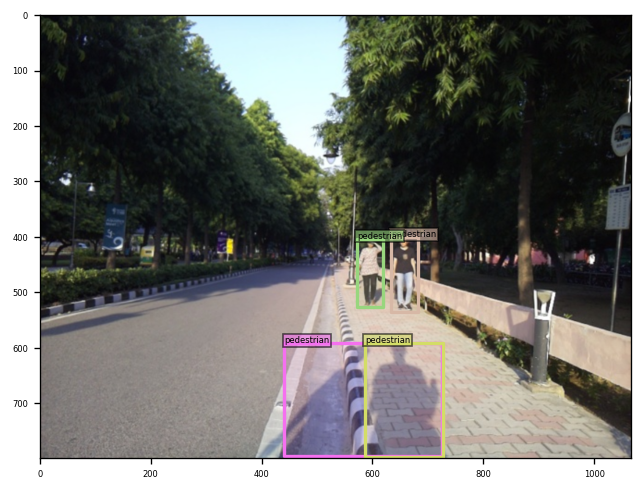

savename: /content/figs/finetuned_model_person_inference/pred_0025.png-119-2024-10-26-17:55:04.201799.png


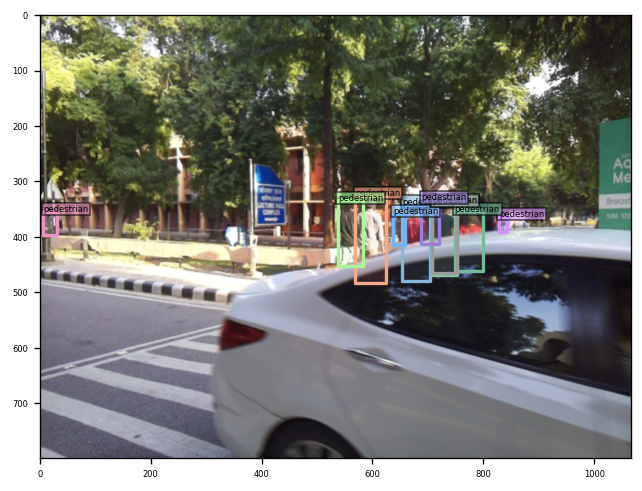

savename: /content/figs/finetuned_model_person_inference/pred_0026.png-123-2024-10-26-17:55:04.767859.png


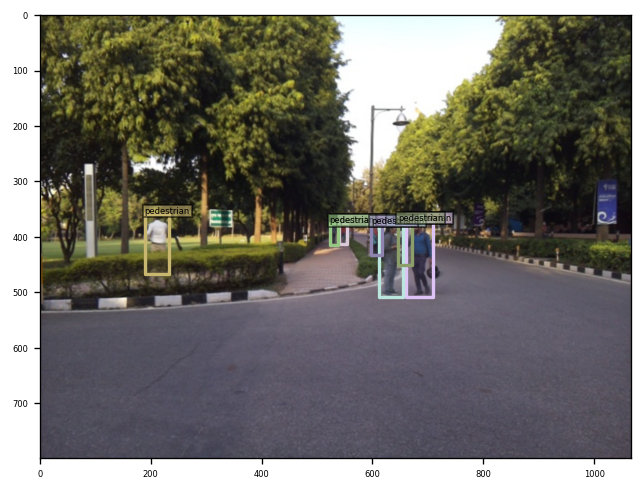

savename: /content/figs/finetuned_model_person_inference/pred_0027.png-128-2024-10-26-17:55:05.336669.png


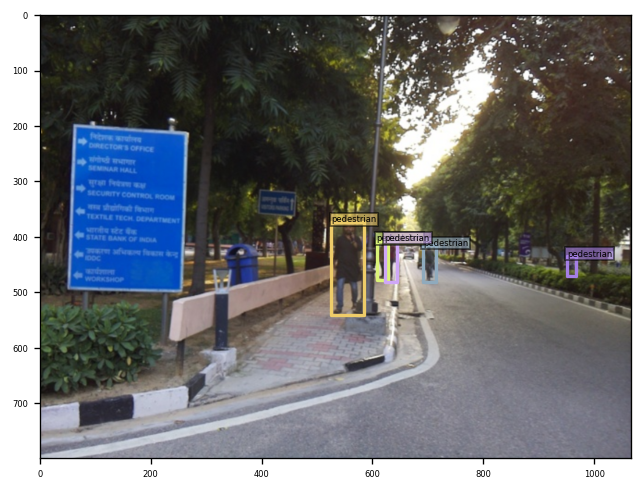

savename: /content/figs/finetuned_model_person_inference/pred_0028.png-141-2024-10-26-17:55:05.893033.png


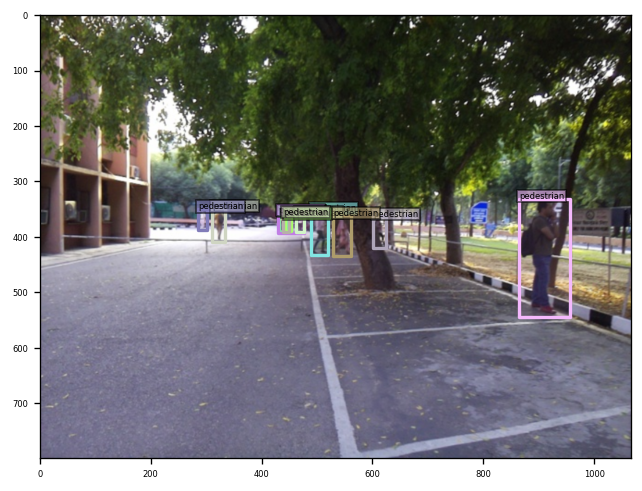

savename: /content/figs/finetuned_model_person_inference/pred_0029.png-150-2024-10-26-17:55:06.467873.png


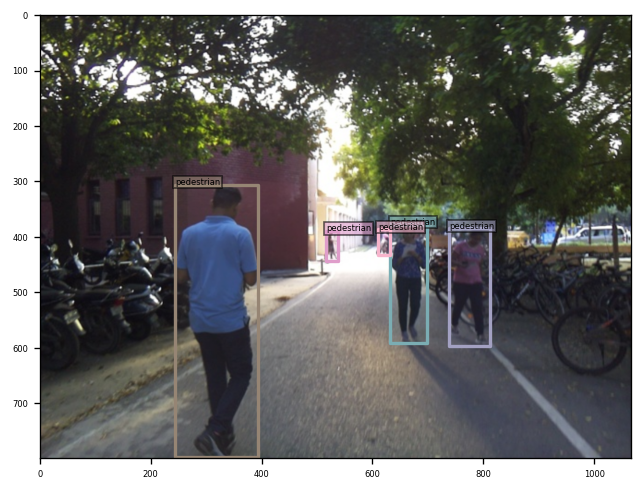

savename: /content/figs/finetuned_model_person_inference/pred_0030.png-156-2024-10-26-17:55:07.036412.png


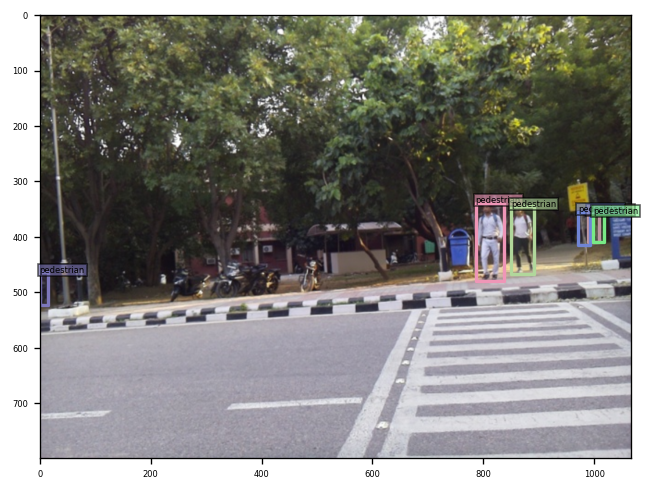

savename: /content/figs/finetuned_model_person_inference/pred_0031.png-164-2024-10-26-17:55:07.594227.png


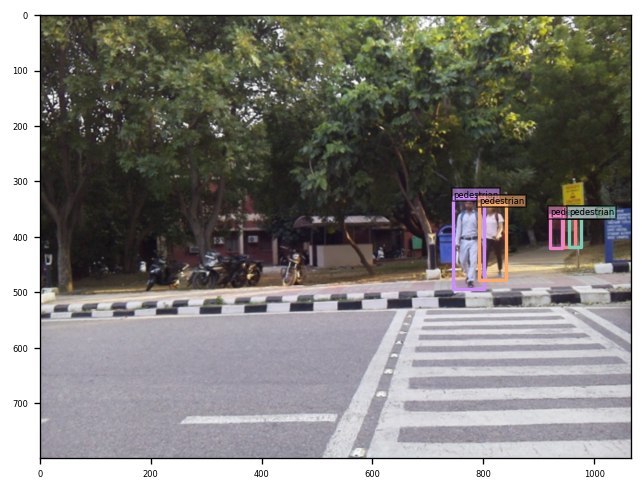

savename: /content/figs/finetuned_model_person_inference/pred_0032.png-165-2024-10-26-17:55:08.151078.png


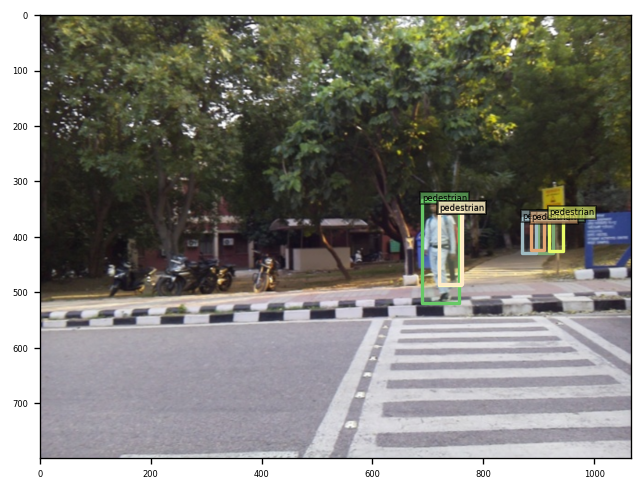

savename: /content/figs/finetuned_model_person_inference/pred_0033.png-166-2024-10-26-17:55:08.719738.png


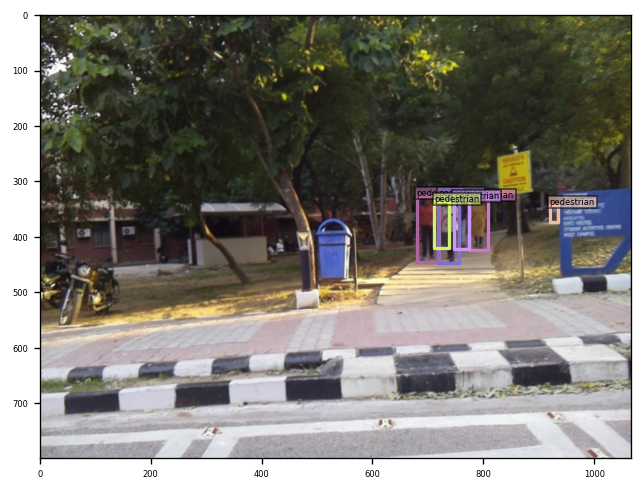

savename: /content/figs/finetuned_model_person_inference/pred_0034.png-172-2024-10-26-17:55:09.284778.png


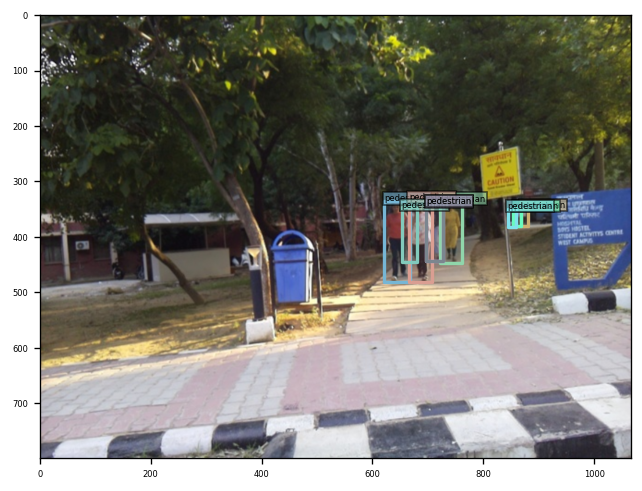

savename: /content/figs/finetuned_model_person_inference/pred_0035.png-173-2024-10-26-17:55:09.868720.png


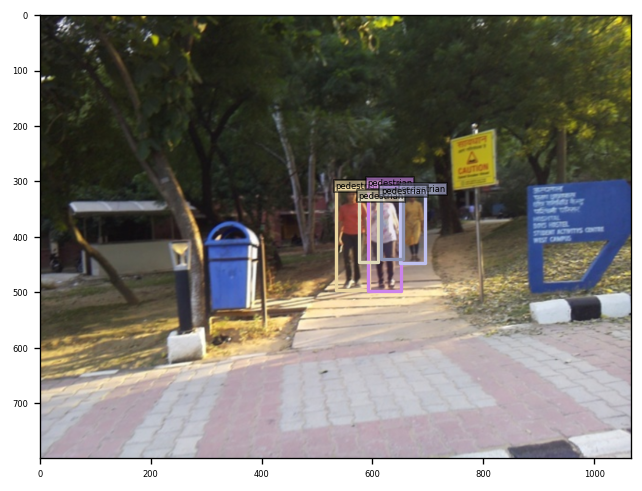

savename: /content/figs/finetuned_model_person_inference/pred_0036.png-175-2024-10-26-17:55:10.433359.png


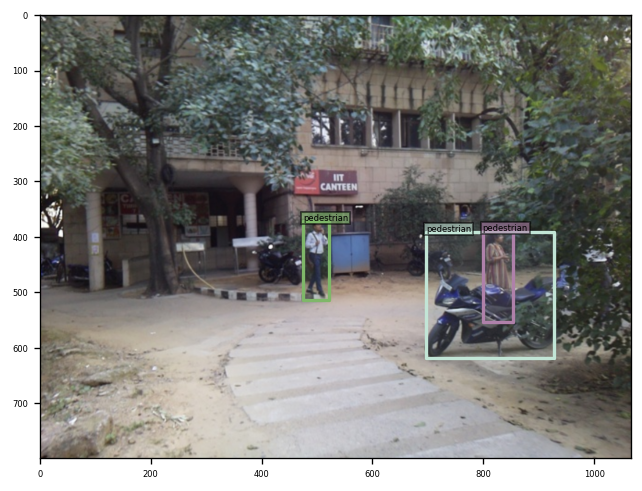

savename: /content/figs/finetuned_model_person_inference/pred_0037.png-176-2024-10-26-17:55:11.020055.png


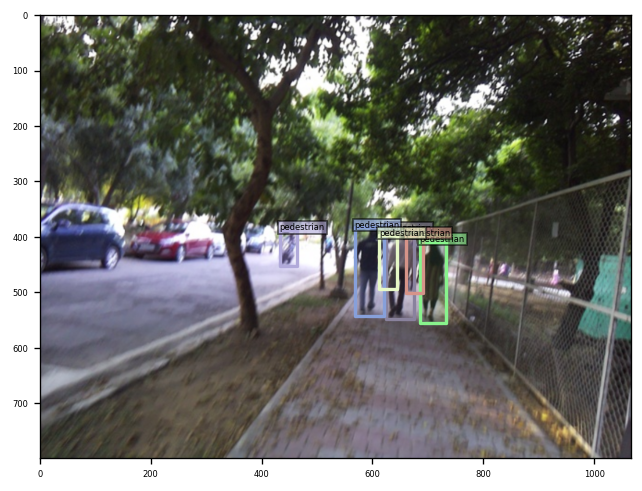

savename: /content/figs/finetuned_model_person_inference/pred_0038.png-186-2024-10-26-17:55:11.609483.png


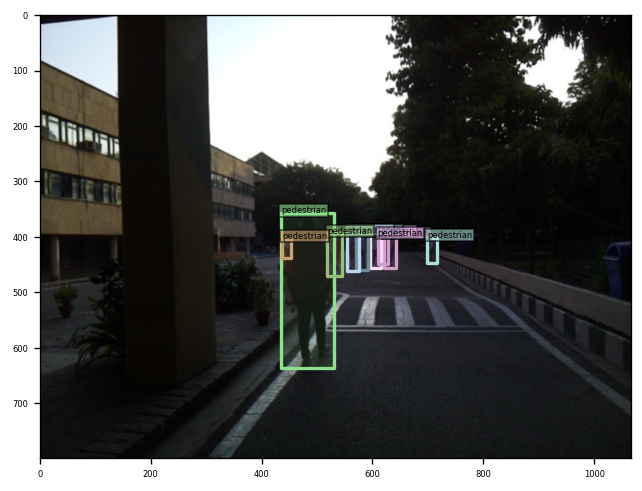

savename: /content/figs/finetuned_model_person_inference/pred_0039.png-197-2024-10-26-17:55:12.134602.png
Error idx: 40


In [8]:
import torch
import numpy as np

from main import build_model_main
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

model_config_path = "/content/config/DINO/DINO_4scale.py"
model_checkpoint_path = "/content/logs/DINO/R50-MS4/checkpoint_best_regular.pth"

args = SLConfig.fromfile(model_config_path)
args.device = 'cuda'
model, criterion, postprocessors = build_model_main(args)

checkpoint = torch.load(model_checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint['model'])
_ = model.eval()

args.dataset_file = 'coco'
args.coco_path = "/content/processed_dataset"
args.fix_size = False

dataset_val = build_dataset(image_set='val', args=args)

for i,batch in enumerate(dataset_val):
    image, targets = batch

    output = model.cuda()(image[None].cuda())
    output = postprocessors['bbox'](output, torch.Tensor([[1.0, 1.0]]).cuda())[0]

    threshold = 0.3

    scores = output['scores']
    labels = output['labels']
    boxes = box_ops.box_xyxy_to_cxcywh(output['boxes'])

    select_mask = scores > threshold

    pred_dict = {
        'boxes': boxes[select_mask],
        'size': targets['size'],
        'image_id': targets['image_id'],
        'box_label': ['pedestrian'] * select_mask.sum().item()
    }

    vslzr = COCOVisualizer()
    vslzr.visualize(image, pred_dict, caption=f"pred_{str(i).zfill(4)}.png", savedir='/content/figs/finetuned_model_person_inference')

In [ ]:
!zip -r /content/logs.zip /content/logs/DINO/R50-MS4

files.download("/content/logs.zip")

updating: content/logs/DINO/R50-MS4/ (stored 0%)
updating: content/logs/DINO/R50-MS4/checkpoint_best_regular.pth (deflated 8%)
updating: content/logs/DINO/R50-MS4/config_args_all.json (deflated 63%)
updating: content/logs/DINO/R50-MS4/info.txt (deflated 86%)
updating: content/logs/DINO/R50-MS4/config_cfg.py (deflated 57%)
updating: content/logs/DINO/R50-MS4/checkpoint0004.pth (deflated 8%)
updating: content/logs/DINO/R50-MS4/checkpoint0009.pth